
📊 DATASET BCDATA – RESUMEN GT (Ki-67)
Total imágenes analizadas        : 803
Imágenes sin archivos .h5       : 0
Imágenes con 0 Ki-67 anotados   : 0
% sin Ki-67 (sobre total imgs)  : 0.00%

📉 5 imágenes con MENOS biomarcadores Ki-67 (pos+neg) (seed=42)

1. 781.png | Ki67=10 (Pos=3, Neg=7) | H5=OK
2. 607.png | Ki67=15 (Pos=1, Neg=14) | H5=OK
3. 590.png | Ki67=20 (Pos=19, Neg=1) | H5=OK
4. 437.png | Ki67=20 (Pos=12, Neg=8) | H5=OK
5. 782.png | Ki67=20 (Pos=2, Neg=18) | H5=OK


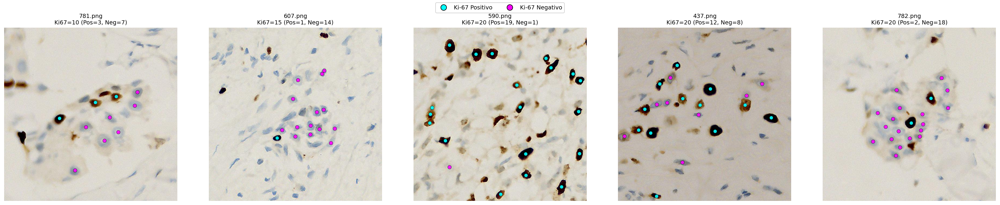

In [11]:
import random
import h5py
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image

BC_ROOT = Path("/media/HDD2/BCData/BCData")
IMG_DIR = BC_ROOT / "images/train"
ANN_DIR = BC_ROOT / "annotations/train"

N_SHOW = 5
SEED = 42

COLOR_POS = "#00FFFF"  
COLOR_NEG = "#FF00FF"  

def load_points_bcdata(img_stem: str, ann_root: Path):
    """
    BCData:
      annotations/train/positive/<stem>.h5
      annotations/train/negative/<stem>.h5
    Cada .h5 contiene dataset 'coordinates' o 'coordinate'

    Retorna pos (Nx2), neg (Mx2) en (x,y)
    """
    def _read_h5(h5_path: Path):
        try:
            with h5py.File(h5_path, "r") as f:
                if "coordinates" in f:
                    return np.asarray(f["coordinates"])
                if "coordinate" in f:
                    return np.asarray(f["coordinate"])
        except Exception:
            return None
        return None

    pos, neg = np.empty((0, 2), dtype=np.float32), np.empty((0, 2), dtype=np.float32)

    h5_pos = ann_root / "positive" / f"{img_stem}.h5"
    h5_neg = ann_root / "negative" / f"{img_stem}.h5"

    if h5_pos.exists():
        coords = _read_h5(h5_pos)
        if coords is not None and len(coords) > 0:
            pos = coords.astype(np.float32)

    if h5_neg.exists():
        coords = _read_h5(h5_neg)
        if coords is not None and len(coords) > 0:
            neg = coords.astype(np.float32)

    return pos, neg

image_paths = sorted(list(IMG_DIR.glob("*.jpg")) + list(IMG_DIR.glob("*.png")))
if not image_paths:
    raise RuntimeError(f"No se encontraron imágenes en {IMG_DIR}")

stats = []
n_zero_ki67 = 0
n_missing_h5 = 0

for img_path in image_paths:
    pos, neg = load_points_bcdata(img_path.stem, ANN_DIR)
    n_pos = int(len(pos))
    n_neg = int(len(neg))
    n_ki67 = n_pos + n_neg

    if n_ki67 == 0:
        n_zero_ki67 += 1

    has_any_h5 = (
        (ANN_DIR / "positive" / f"{img_path.stem}.h5").exists()
        or (ANN_DIR / "negative" / f"{img_path.stem}.h5").exists()
    )
    if not has_any_h5:
        n_missing_h5 += 1

    stats.append({
        "img_path": img_path,
        "n_pos": n_pos,
        "n_neg": n_neg,
        "n_ki67": n_ki67,
        "pos": pos,
        "neg": neg,
        "has_any_h5": has_any_h5
    })

print("\nDATASET BCDATA – RESUMEN GT (Ki-67)")
print(f"Total imágenes analizadas        : {len(stats)}")
print(f"Imágenes sin archivos .h5       : {n_missing_h5}")
print(f"Imágenes con 0 Ki-67 anotados   : {n_zero_ki67}")
print(f"% sin Ki-67 (sobre total imgs)  : {(n_zero_ki67 / len(stats)) * 100:.2f}%")

random.seed(SEED)

by_count = {}
for d in stats:
    by_count.setdefault(d["n_ki67"], []).append(d)

selected = []
for k in sorted(by_count.keys()):  
    group = by_count[k]
    random.shuffle(group)        
    need = N_SHOW - len(selected)
    if need <= 0:
        break
    selected.extend(group[:need])

top = selected  

print(f"\n{len(top)} imágenes con MENOS biomarcadores Ki-67 (pos+neg) (seed={SEED})\n")
for i, d in enumerate(top, 1):
    print(
        f"{i}. {d['img_path'].name} | "
        f"Ki67={d['n_ki67']} (Pos={d['n_pos']}, Neg={d['n_neg']}) | "
        f"H5={'OK' if d['has_any_h5'] else 'MISSING'}"
    )

cols = len(top)
fig, axes = plt.subplots(1, cols, figsize=(5 * cols, 5), dpi=140)
if cols == 1:
    axes = [axes]

for ax, d in zip(axes, top):
    img = Image.open(d["img_path"]).convert("RGB")
    ax.imshow(img)

    if d["n_pos"] > 0:
        ax.scatter(
            d["pos"][:, 0], d["pos"][:, 1],
            s=40, c=COLOR_POS,
            edgecolors="black", linewidths=0.4,
            alpha=0.9
        )
    if d["n_neg"] > 0:
        ax.scatter(
            d["neg"][:, 0], d["neg"][:, 1],
            s=40, c=COLOR_NEG,
            edgecolors="black", linewidths=0.4,
            alpha=0.9
        )

    ax.set_title(
        f"{d['img_path'].name}\nKi67={d['n_ki67']} (Pos={d['n_pos']}, Neg={d['n_neg']})",
        fontsize=10
    )
    ax.axis("off")

handles = [
    plt.Line2D([0], [0], marker='o', color='w',
               markerfacecolor=COLOR_POS, markeredgecolor='black',
               markersize=10, label='Ki-67 Positivo'),
    plt.Line2D([0], [0], marker='o', color='w',
               markerfacecolor=COLOR_NEG, markeredgecolor='black',
               markersize=10, label='Ki-67 Negativo')
]
fig.legend(handles=handles, loc="upper center", ncol=2, framealpha=0.9)

plt.tight_layout(rect=[0, 0, 1, 0.92])
plt.show()


In [1]:

import os, h5py, contextlib, logging, warnings
from pathlib import Path
from dataclasses import dataclass
from typing import Dict, List, Tuple

import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F

from tqdm.auto import tqdm
from torchvision import transforms, models
from torch.utils.data import Dataset, DataLoader
from skimage.measure import regionprops

from cellpose import models as cp_models, io as cp_io

BC_ROOT = Path("/media/HDD2/BCData/BCData")

IMG_DIR = BC_ROOT / "images/train"
ANN_DIR = BC_ROOT / "annotations/train" 

CKPT_PATH = Path("/media/HDD2/BCData_Training_Compare/convnext_tiny_lr5e-05_wd0.0001_bs32/best_f1posneg.pth")

IDX_TO_CLASS = {0: "background", 1: "ki67_neg", 2: "ki67_pos"} 
GT_MAP = {1: "ki67_pos", 2: "ki67_neg"}                      

THRESHOLD = 0.98
PATCH_SIZE = 50

CELLPOSE_MODEL_TYPE = "cpsam"
CELLPOSE_DIAMETER = 47
CELLPOSE_INVERT = True
CELLPOSE_CELLPROB_THRESHOLD = -1.0
CELLPOSE_FLOW_THRESHOLD = 0.8
CELLPOSE_MIN_SIZE = 20

BATCH_INFER = 64
NUM_WORKERS = 2

OUT_CSV_IMG = Path("./fp_by_image_convnext_thr098.csv")
OUT_CSV_FP  = Path("./fp_points_convnext_thr098.csv")

COLOR_GT_POS = "#00FFFF"  
COLOR_GT_NEG = "#FF00FF"   
COLOR_FP_POS = "#FF0000"   
COLOR_FP_NEG = "#FFA500"  


def set_seed(seed: int = 42):
    import random
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

def load_checkpoint_state_dict(ckpt_path: Path, device: torch.device) -> Dict[str, torch.Tensor]:
    ckpt = torch.load(str(ckpt_path), map_location=device)
    if isinstance(ckpt, dict) and "model" in ckpt and isinstance(ckpt["model"], dict):
        return ckpt["model"]
    if isinstance(ckpt, dict) and "state_dict" in ckpt and isinstance(ckpt["state_dict"], dict):
        return ckpt["state_dict"]
    if isinstance(ckpt, dict):
        return ckpt
    raise RuntimeError(f"No pude inferir state_dict desde: {ckpt_path}")

def build_convnext_tiny(num_classes: int, device: torch.device):
    m = models.convnext_tiny(weights=None)
    in_features = m.classifier[2].in_features
    m.classifier[2] = nn.Linear(in_features, num_classes)
    return m.to(device)

class PatchDataset(Dataset):
    def __init__(self, patches_bgr: List[np.ndarray]):
        self.patches = patches_bgr
        self.tf = transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize((224, 224)),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406],
                                 [0.229, 0.224, 0.225]),
        ])
    def __len__(self): return len(self.patches)
    def __getitem__(self, idx):
        bgr = self.patches[idx]
        rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
        return self.tf(rgb)

def get_smart_patch(img_bgr: np.ndarray, cx: float, cy: float, size: int) -> np.ndarray:
    h, w = img_bgr.shape[:2]
    half = size // 2
    x1, y1 = int(round(cx - half)), int(round(cy - half))
    x2, y2 = x1 + size, y1 + size

    pad_l, pad_t = max(0, -x1), max(0, -y1)
    pad_r, pad_b = max(0, x2 - w), max(0, y2 - h)

    crop_x1, crop_y1 = max(0, x1), max(0, y1)
    crop_x2, crop_y2 = min(w, x2), min(h, y2)

    patch = img_bgr[crop_y1:crop_y2, crop_x1:crop_x2]
    if pad_l or pad_t or pad_r or pad_b:
        patch = cv2.copyMakeBorder(
            patch, pad_t, pad_b, pad_l, pad_r, borderType=cv2.BORDER_REFLECT
        )
    return patch

def infer_probs_for_patches(model: nn.Module, patches_bgr: List[np.ndarray], device: torch.device,
                            batch_size: int, num_workers: int = 0) -> np.ndarray:
    if len(patches_bgr) == 0:
        return np.zeros((0, 3), dtype=np.float32)

    ds = PatchDataset(patches_bgr)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=False, num_workers=num_workers)

    probs = []
    use_cuda = (device.type == "cuda")
    amp_device = "cuda" if use_cuda else "cpu"

    model.eval()
    with torch.no_grad():
        for batch in dl:
            batch = batch.to(device, non_blocking=True)
            with torch.amp.autocast(device_type=amp_device, enabled=use_cuda):
                logits = model(batch)
                p = F.softmax(logits, dim=1).float().detach().cpu().numpy()
            probs.append(p)
    return np.concatenate(probs, axis=0)

def apply_threshold_rule(probs: np.ndarray, thr: float) -> np.ndarray:
    """
    Regla:
      si p_bg > thr => BG
      else => argmax entre pos/neg (p_pos vs p_neg)
    """
    if probs.shape[0] == 0:
        return np.zeros((0,), dtype=np.int64)

    p_bg = probs[:, 0]
    p_neg = probs[:, 1]
    p_pos = probs[:, 2]

    pred = np.where(
        p_bg > thr,
        0,
        np.where(p_pos > p_neg, 2, 1)
    ).astype(np.int64)
    return pred


In [2]:

def load_gt_bcdata_points(img_stem: str, ann_root: Path) -> List[dict]:
    """
    Devuelve lista unificada:
      [{'x': float, 'y': float, 'label_id': 1(pos) o 2(neg)}]
    """
    unified = []
    h5_name = f"{img_stem}.h5"
    paths = [
        (ann_root / "positive" / h5_name, 1),
        (ann_root / "negative" / h5_name, 2),
    ]

    def _read_coords(h5_path: Path):
        try:
            with h5py.File(h5_path, "r") as f:
                if "coordinates" in f.keys():
                    return np.asarray(f["coordinates"])
                if "coordinate" in f.keys():
                    return np.asarray(f["coordinate"])
        except Exception:
            return None
        return None

    for p_path, label_id in paths:
        if not p_path.exists():
            continue
        coords = _read_coords(p_path)
        if coords is None:
            continue
        for pt in coords:
            unified.append({"x": float(pt[0]), "y": float(pt[1]), "label_id": label_id})

    return unified

def gt_split_posneg(gt_points: List[dict]) -> Tuple[np.ndarray, np.ndarray]:
    pos, neg = [], []
    for pt in gt_points:
        cls = GT_MAP.get(int(pt["label_id"]), "unknown")
        if cls == "ki67_pos":
            pos.append([pt["x"], pt["y"]])
        elif cls == "ki67_neg":
            neg.append([pt["x"], pt["y"]])
    return np.array(pos), np.array(neg)


@dataclass
class ImageArtifacts:
    img_path: Path
    img_rgb: np.ndarray
    img_bgr: np.ndarray
    masks: np.ndarray
    cand_xy_maskid: List[Tuple[float, float, int]]
    patches_bgr: List[np.ndarray]
    gt_points: List[dict]

def segment_and_extract_bcdata(img_path: Path, ann_root: Path, cellpose_model, patch_size: int, cp_eval_params: dict) -> ImageArtifacts:
    img_rgb = cp_io.imread(str(img_path))
    img_bgr = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2BGR)

    gt_points = load_gt_bcdata_points(img_path.stem, ann_root)

    masks, _, _ = cellpose_model.eval(img_rgb, **cp_eval_params)
    props = regionprops(masks)

    patches, cand = [], []
    for p in props:
        cy, cx = p.centroid
        patches.append(get_smart_patch(img_bgr, cx, cy, patch_size))
        cand.append((float(cx), float(cy), int(p.label)))

    return ImageArtifacts(
        img_path=img_path,
        img_rgb=img_rgb,
        img_bgr=img_bgr,
        masks=masks,
        cand_xy_maskid=cand,
        patches_bgr=patches,
        gt_points=gt_points
    )


def collect_fp_points(
    image_name: str,
    masks: np.ndarray,
    cand_xy_maskid: List[Tuple[float, float, int]],
    pred_idx: np.ndarray,
    gt_points: List[dict],
    idx_to_class: Dict[int, str],
    gt_map: Dict[int, str],
    threshold: float,
) -> Tuple[Dict[str, int], List[dict]]:
    """
    reason:
      - "no_gt_in_mask": no hubo GT pos/neg dentro de esa máscara
      - "wrong_class": hubo GT en máscara, pero clase distinta
    """
    fp_pos = 0
    fp_neg = 0
    fp_points: List[dict] = []

    gt_used = [False] * len(gt_points)

    for i, pidx in enumerate(pred_idx):
        pred_cls = idx_to_class[int(pidx)]
        cx, cy, mask_id = cand_xy_maskid[i]

        if pred_cls == "background":
            continue
        if pred_cls not in ("ki67_pos", "ki67_neg"):
            continue

        matched = False
        match_gt_cls = None

        for g_i, pt in enumerate(gt_points):
            if gt_used[g_i]:
                continue
            gt_cls = gt_map.get(int(pt["label_id"]), "unknown")
            if gt_cls not in ("ki67_pos", "ki67_neg"):
                continue

            gx, gy = float(pt["x"]), float(pt["y"])
            iy, ix = int(round(gy)), int(round(gx))
            if 0 <= iy < masks.shape[0] and 0 <= ix < masks.shape[1]:
                if int(masks[iy, ix]) == int(mask_id):
                    matched = True
                    gt_used[g_i] = True
                    match_gt_cls = gt_cls
                    break

        if not matched:
            if pred_cls == "ki67_pos":
                fp_pos += 1
            else:
                fp_neg += 1
            fp_points.append({
                "image": image_name,
                "x": float(cx),
                "y": float(cy),
                "pred_class": pred_cls,
                "reason": "no_gt_in_mask",
                "mask_id": int(mask_id),
                "threshold": float(threshold),
            })
        else:
            if pred_cls != match_gt_cls:
                if pred_cls == "ki67_pos":
                    fp_pos += 1
                else:
                    fp_neg += 1
                fp_points.append({
                    "image": image_name,
                    "x": float(cx),
                    "y": float(cy),
                    "pred_class": pred_cls,
                    "reason": "wrong_class",
                    "mask_id": int(mask_id),
                    "threshold": float(threshold),
                })

    return {"fp_pos": fp_pos, "fp_neg": fp_neg}, fp_points





In [3]:

set_seed(42)

warnings.filterwarnings("ignore")
cp_io.logger_setup()
logging.getLogger("cellpose").setLevel(logging.CRITICAL)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Device:", device)

img_files = sorted(list(IMG_DIR.glob("*.png")) + list(IMG_DIR.glob("*.jpg")))
if not img_files:
    raise FileNotFoundError(f"No hay imágenes en {IMG_DIR}")

print("Cargando Cellpose...")
cp = cp_models.CellposeModel(gpu=torch.cuda.is_available(), pretrained_model=CELLPOSE_MODEL_TYPE)
cp_eval_params = dict(
    diameter=CELLPOSE_DIAMETER,
    invert=bool(CELLPOSE_INVERT),
    cellprob_threshold=CELLPOSE_CELLPROB_THRESHOLD,
    flow_threshold=CELLPOSE_FLOW_THRESHOLD,
    min_size=CELLPOSE_MIN_SIZE
)

print("Cargando ConvNeXt...")
convnext = build_convnext_tiny(num_classes=3, device=device)
sd = load_checkpoint_state_dict(CKPT_PATH, device=device)
convnext.load_state_dict(sd, strict=True)
convnext.eval()

rows_image = []
rows_fp_points = []

for ip in tqdm(img_files, desc="BCData: Infer + FP export"):
    art = segment_and_extract_bcdata(
        img_path=ip,
        ann_root=ANN_DIR,
        cellpose_model=cp,
        patch_size=PATCH_SIZE,
        cp_eval_params=cp_eval_params
    )

    probs = infer_probs_for_patches(
        model=convnext,
        patches_bgr=art.patches_bgr,
        device=device,
        batch_size=BATCH_INFER,
        num_workers=NUM_WORKERS
    )
    pred_idx = apply_threshold_rule(probs, THRESHOLD)

    fp_counts, fp_points = collect_fp_points(
        image_name=ip.name,
        masks=art.masks,
        cand_xy_maskid=art.cand_xy_maskid,
        pred_idx=pred_idx,
        gt_points=art.gt_points,
        idx_to_class=IDX_TO_CLASS,
        gt_map=GT_MAP,
        threshold=THRESHOLD,
    )

    rows_image.append({
        "image": ip.name,
        "fp_pos": fp_counts["fp_pos"],
        "fp_neg": fp_counts["fp_neg"],
        "n_candidates": len(art.cand_xy_maskid),
        "n_gt_points_total": len(art.gt_points),
        "threshold": THRESHOLD
    })
    rows_fp_points.extend(fp_points)

df_img = pd.DataFrame(rows_image)
df_fp  = pd.DataFrame(rows_fp_points)

df_img.to_csv(OUT_CSV_IMG, index=False)
df_fp.to_csv(OUT_CSV_FP, index=False)

print(f"\nGuardado resumen por imagen: {OUT_CSV_IMG}")
print(f"Guardado FP puntuales      : {OUT_CSV_FP}")
print(f"Total FP puntuales exportados : {len(df_fp)}")


2026-01-13 17:10:12,972 [INFO] WRITING LOG OUTPUT TO /home/claudio/.cellpose/run.log
2026-01-13 17:10:12,975 [INFO] 
cellpose version: 	4.0.8 
platform:       	linux 
python version: 	3.10.18 
torch version:  	2.5.1
Device: cuda
🦠 Cargando Cellpose...
🧠 Cargando ConvNeXt...


BCData: Infer + FP export:   0%|          | 0/803 [00:00<?, ?it/s]


✅ Guardado resumen por imagen: fp_by_image_convnext_thr098.csv
✅ Guardado FP puntuales      : fp_points_convnext_thr098.csv
Total FP puntuales exportados : 32048


In [4]:

top5_fp_pos = df_img.sort_values("fp_pos", ascending=False).head(5).reset_index(drop=True)
top5_fp_neg = df_img.sort_values("fp_neg", ascending=False).head(5).reset_index(drop=True)

display(top5_fp_pos)
display(top5_fp_neg)


,image,fp_pos,fp_neg,n_candidates,n_gt_points_total,threshold
0,414.png,67,7,254,195,0.98
1,445.png,67,5,199,123,0.98
2,176.png,61,35,250,134,0.98
3,538.png,57,36,216,74,0.98
4,184.png,56,29,170,65,0.98


,image,fp_pos,fp_neg,n_candidates,n_gt_points_total,threshold
0,714.png,32,120,287,87,0.98
1,515.png,4,110,246,104,0.98
2,605.png,8,104,294,66,0.98
3,516.png,27,104,260,87,0.98
4,706.png,6,104,333,162,0.98


In [9]:

def show_images_with_gt_and_fp_bcdata(image_names, title, ncols=5):
    n = len(image_names)
    ncols = min(ncols, n)
    nrows = 2 * int(np.ceil(n / ncols)) 

    fig, axes = plt.subplots(
        nrows, ncols,
        figsize=(5 * ncols + 3, 5 * nrows),
        dpi=250
    )
    if nrows == 1:
        axes = np.array(axes).reshape(1, -1)

    fig.suptitle(title, fontsize=14, fontweight="bold")

    for i, img_name in enumerate(image_names):
        col = i % ncols
        row_overlay = 2 * (i // ncols)
        row_clean   = row_overlay + 1

        ax_overlay = axes[row_overlay, col]
        ax_clean   = axes[row_clean, col]
        ax_overlay.axis("off")
        ax_clean.axis("off")

        img_path = IMG_DIR / img_name
        if not img_path.exists():
            ax_overlay.text(0.5, 0.5, f"NO ENCONTRADA\n{img_name}", ha="center", va="center")
            ax_clean.text(0.5, 0.5, f"NO ENCONTRADA\n{img_name}", ha="center", va="center")
            continue

        img = Image.open(img_path).convert("RGB")

        ax_overlay.imshow(img)
        gt_points = load_gt_bcdata_points(img_path.stem, ANN_DIR)
        pos, neg = gt_split_posneg(gt_points)

        if len(pos) > 0:
            ax_overlay.scatter(pos[:, 0], pos[:, 1],
                               s=45, c=COLOR_GT_POS,
                               edgecolors="black", linewidths=0.4,
                               alpha=0.9)
        if len(neg) > 0:
            ax_overlay.scatter(neg[:, 0], neg[:, 1],
                               s=45, c=COLOR_GT_NEG,
                               edgecolors="black", linewidths=0.4,
                               alpha=0.9)

        sub_fp = df_fp[df_fp["image"] == img_name]

        def plot_fp(df_sub, color):
            for reason, marker in [("no_gt_in_mask", "x"), ("wrong_class", "^")]:
                dfr = df_sub[df_sub["reason"] == reason]
                if dfr.empty:
                    continue
                ax_overlay.scatter(dfr["x"], dfr["y"],
                                   s=70, c=color, marker=marker,
                                   linewidths=1.8, alpha=0.95)

        plot_fp(sub_fp[sub_fp["pred_class"] == "ki67_pos"], COLOR_FP_POS)
        plot_fp(sub_fp[sub_fp["pred_class"] == "ki67_neg"], COLOR_FP_NEG)

        ax_overlay.set_title(
            f"{img_name}\nGT(Ki67)={len(pos)+len(neg)} | FP_pos={len(sub_fp[sub_fp.pred_class=='ki67_pos'])} FP_neg={len(sub_fp[sub_fp.pred_class=='ki67_neg'])}",
            fontsize=9, pad=2
        )

        ax_clean.imshow(img)
        ax_clean.set_title("Imagen original", fontsize=8, pad=1, color="gray")

    handles = [
        plt.Line2D([0], [0], marker='o', color='w',
                   markerfacecolor=COLOR_GT_POS, markeredgecolor='black',
                   markersize=9, label='GT Ki-67 Positivo'),
        plt.Line2D([0], [0], marker='o', color='w',
                   markerfacecolor=COLOR_GT_NEG, markeredgecolor='black',
                   markersize=9, label='GT Ki-67 Negativo'),

        plt.Line2D([0], [0], marker='x', color=COLOR_FP_POS,
                   markersize=9, linestyle='None', label='FP Pos (sin GT en máscara)'),
        plt.Line2D([0], [0], marker='^', color=COLOR_FP_POS,
                   markersize=9, linestyle='None', label='FP Pos (wrong class)'),

        plt.Line2D([0], [0], marker='x', color=COLOR_FP_NEG,
                   markersize=9, linestyle='None', label='FP Neg (sin GT en máscara)'),
        plt.Line2D([0], [0], marker='^', color=COLOR_FP_NEG,
                   markersize=9, linestyle='None', label='FP Neg (wrong class)'),
    ]

    fig.legend(handles=handles, loc="upper right", ncol=3, framealpha=0.1)
    plt.tight_layout(rect=[0, 0, 1, 0.98])  
    plt.show()


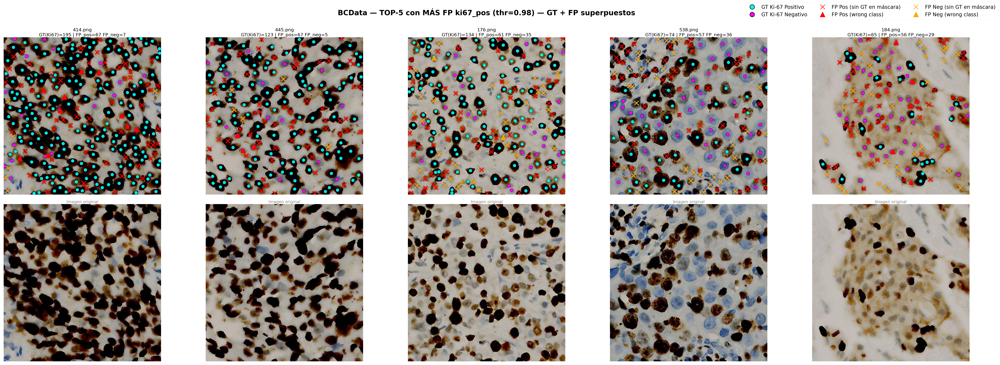

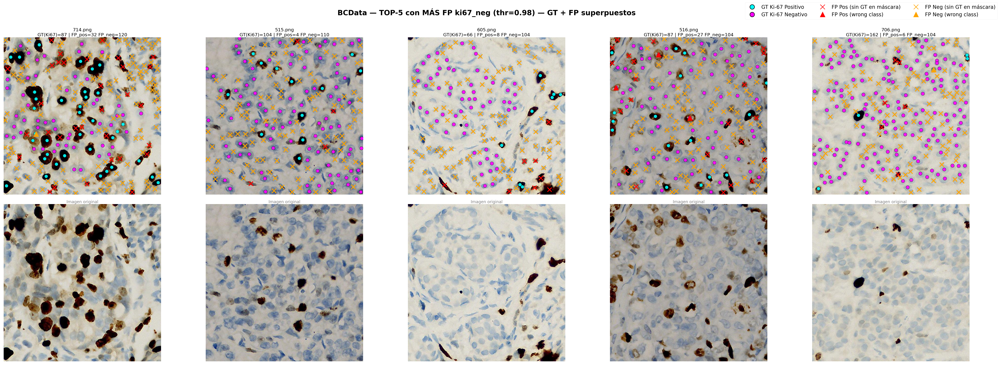

In [10]:

show_images_with_gt_and_fp_bcdata(
    top5_fp_pos["image"].tolist(),
    title=f"BCData — TOP-5 con MÁS FP ki67_pos (thr={THRESHOLD}) — GT + FP superpuestos"
)

show_images_with_gt_and_fp_bcdata(
    top5_fp_neg["image"].tolist(),
    title=f"BCData — TOP-5 con MÁS FP ki67_neg (thr={THRESHOLD}) — GT + FP superpuestos"
)
